/var/folders/rd/3c9ss4qx6kd9rtm4q1r5kfj00000gn/T/ipykernel_5996/3137341389.py:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("jet", 4)


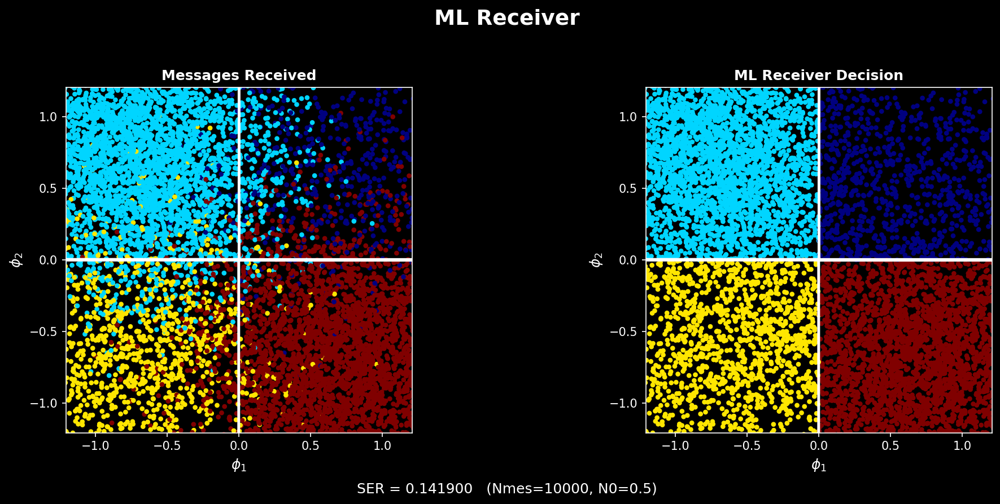

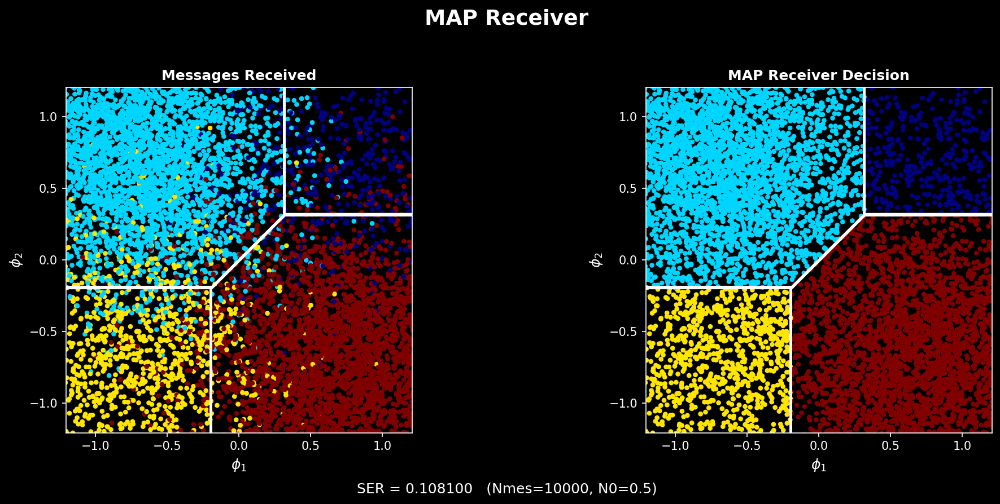

ML  SER = 0.141900
MAP SER = 0.108100


In [9]:
import numpy as np
import matplotlib.pyplot as plt

def make_plots(Nmes=10000, N0=0.5, grid_n=200, seed=7):
    np.random.seed(seed)

    # ----- Prior distribution -----
    p = np.array([1/15, 6/15, 2/15, 6/15], dtype=float)

    # ----- 4-QAM signal-space coordinates -----
    Ts = 1.0
    Al = np.array([ 1, -1, -1,  1], dtype=float) / np.sqrt(2*Ts)
    Bl = np.array([ 1,  1, -1, -1], dtype=float) / np.sqrt(2*Ts)

    # ----- Generate messages following p -----
    m = np.random.choice(np.array([0, 1, 2, 3]), size=Nmes, p=p)

    # ----- AWGN in projection domain -----
    sigma = np.sqrt(N0 / 2.0)  # per-dimension std
    r1 = Al[m] + sigma * np.random.randn(Nmes)
    r2 = Bl[m] + sigma * np.random.randn(Nmes)

    # ----- ML + MAP decisions -----
    scores_ml  = r1[:, None] * Al[None, :] + r2[:, None] * Bl[None, :]
    mrec_ml = np.argmax(scores_ml, axis=1)

    scores_map = scores_ml + (N0 / 2.0) * np.log(p[None, :])
    mrec_map = np.argmax(scores_map, axis=1)

    # ----- Decision region grid -----
    phi1_min, phi1_max = Al.min() - 0.5, Al.max() + 0.5
    phi2_min, phi2_max = Bl.min() - 0.5, Bl.max() + 0.5

    phi1_vals = np.linspace(phi1_min, phi1_max, grid_n)
    phi2_vals = np.linspace(phi2_min, phi2_max, grid_n)
    phi1_grid, phi2_grid = np.meshgrid(phi1_vals, phi2_vals)

    r1g = phi1_grid.ravel()
    r2g = phi2_grid.ravel()

    scores_ml_g = r1g[:, None] * Al[None, :] + r2g[:, None] * Bl[None, :]
    regions_ml = np.argmax(scores_ml_g, axis=1).reshape(phi1_grid.shape) + 1

    scores_map_g = scores_ml_g + (N0 / 2.0) * np.log(p[None, :])
    regions_map = np.argmax(scores_map_g, axis=1).reshape(phi1_grid.shape) + 1

    # ----- Plot settings -----
    plt.style.use("dark_background")
    cmap = plt.cm.get_cmap("jet", 4)

    def plot_receiver(fig_title, rec_title, m_hat, regions):
        ser = np.mean(m_hat != m)

        fig, ax = plt.subplots(1, 2, figsize=(14, 6), dpi=150)
        fig.suptitle(fig_title, fontsize=18, fontweight="bold")

        # Left: messages received (true label)
        ax[0].scatter(r1, r2, s=10, c=m, cmap=cmap, vmin=0, vmax=3)
        ax[0].contour(phi1_grid, phi2_grid, regions, colors="w", linewidths=1.8)
        ax[0].set_title("Messages Received", fontsize=12, fontweight="bold")

        # Right: receiver decision (decided label)
        ax[1].scatter(r1, r2, s=10, c=m_hat, cmap=cmap, vmin=0, vmax=3)
        ax[1].contour(phi1_grid, phi2_grid, regions, colors="w", linewidths=1.8)
        ax[1].set_title(rec_title, fontsize=12, fontweight="bold")

        for a in ax:
            a.set_xlabel(r"$\phi_1$", fontsize=12)
            a.set_ylabel(r"$\phi_2$", fontsize=12)
            a.set_aspect("equal", adjustable="box")
            a.set_xlim(phi1_min, phi1_max)
            a.set_ylim(phi2_min, phi2_max)

        # Footer SER
        fig.text(0.5, 0.02, f"SER = {ser:.6f}   (Nmes={Nmes}, N0={N0})",
                 ha="center", va="bottom", fontsize=12)

        plt.tight_layout(rect=[0, 0.04, 1, 0.95])  # leave space for footer + suptitle
        plt.show()

        return ser

    ser_ml  = plot_receiver("ML Receiver",  "ML Receiver Decision",  mrec_ml,  regions_ml)
    ser_map = plot_receiver("MAP Receiver", "MAP Receiver Decision", mrec_map, regions_map)

    print(f"ML  SER = {ser_ml:.6f}")
    print(f"MAP SER = {ser_map:.6f}")


if __name__ == "__main__":
    make_plots(Nmes=10000, N0=0.5, grid_n=200, seed=7)

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML, display

def animate_and_save_map_ml_sweep_reflect(
    list_N0,
    out_path="/images//map_ml_sweep.gif",
    Nmes=10000,
    grid_n=250,
    seed=7,
    fps=2
):
    np.random.seed(seed)

    # ----- Priors -----
    p = np.array([1/15, 6/15, 2/15, 6/15], dtype=float)

    # ----- 4-QAM basis coordinates (same structure as your MATLAB Al/Bl) -----
    Ts = 1.0
    Al = np.array([ 1, -1, -1,  1], dtype=float) / np.sqrt(2*Ts)
    Bl = np.array([ 1,  1, -1, -1], dtype=float) / np.sqrt(2*Ts)

    # ----- Fixed messages + fixed standard noise (so only sigma changes with N0) -----
    m = np.random.choice(np.array([0, 1, 2, 3]), size=Nmes, p=p)
    z1 = np.random.randn(Nmes)
    z2 = np.random.randn(Nmes)

    # ----- Grid for decision regions -----
    phi1_min, phi1_max = Al.min() - 0.5, Al.max() + 0.5
    phi2_min, phi2_max = Bl.min() - 0.5, Bl.max() + 0.5
    phi1 = np.linspace(phi1_min, phi1_max, grid_n)
    phi2 = np.linspace(phi2_min, phi2_max, grid_n)
    phi1_grid, phi2_grid = np.meshgrid(phi1, phi2)
    r1g = phi1_grid.ravel()
    r2g = phi2_grid.ravel()

    # ML regions on grid (independent of N0)
    scores_ml_g = r1g[:, None] * Al[None, :] + r2g[:, None] * Bl[None, :]
    regions_ml = np.argmax(scores_ml_g, axis=1).reshape(grid_n, grid_n).astype(np.int16)

    def boundary_mask(reg):
        b = np.zeros_like(reg, dtype=np.uint8)
        b[1:, :] |= (reg[1:, :] != reg[:-1, :])
        b[:, 1:] |= (reg[:, 1:] != reg[:, :-1])
        return b

    ml_boundary = boundary_mask(regions_ml)

    # ----- Plot setup -----
    plt.style.use("dark_background")
    cmap = plt.colormaps["jet"].resampled(4)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10), dpi=150)
    fig.suptitle("ML & MAP Receiver (sweep over $N_0$)", fontsize=16, fontweight="bold")

    titles = [
        ("ML: Messages Received", "ML: Receiver Decision"),
        ("MAP: Messages Received", "MAP: Receiver Decision"),
    ]
    for i in range(2):
        for j in range(2):
            ax[i, j].set_title(titles[i][j], fontsize=12, fontweight="bold")
            ax[i, j].set_xlabel(r"$\phi_1$")
            ax[i, j].set_ylabel(r"$\phi_2$")
            ax[i, j].set_xlim(phi1_min, phi1_max)
            ax[i, j].set_ylim(phi2_min, phi2_max)
            ax[i, j].set_aspect("equal", adjustable="box")

    extent = [phi1_min, phi1_max, phi2_min, phi2_max]

    # ML boundary overlays (white)
    ax[0, 0].imshow(ml_boundary, origin="lower", extent=extent, cmap="gray", vmin=0, vmax=1, alpha=0.85)
    ax[0, 1].imshow(ml_boundary, origin="lower", extent=extent, cmap="gray", vmin=0, vmax=1, alpha=0.85)

    # MAP boundary overlays (updated each frame)
    map_boundary_img_00 = ax[1, 0].imshow(ml_boundary, origin="lower", extent=extent, cmap="gray", vmin=0, vmax=1, alpha=0.85)
    map_boundary_img_01 = ax[1, 1].imshow(ml_boundary, origin="lower", extent=extent, cmap="gray", vmin=0, vmax=1, alpha=0.85)

    # Create scatter artists ONCE (avoid remove() -> prevents your error + duplicate outputs)
    dummy_xy = np.zeros((Nmes, 2))
    scat_ml_rx  = ax[0, 0].scatter(dummy_xy[:, 0], dummy_xy[:, 1], s=10, c=m, cmap=cmap, vmin=0, vmax=3)
    scat_ml_dec = ax[0, 1].scatter(dummy_xy[:, 0], dummy_xy[:, 1], s=10, c=m, cmap=cmap, vmin=0, vmax=3)
    scat_mp_rx  = ax[1, 0].scatter(dummy_xy[:, 0], dummy_xy[:, 1], s=10, c=m, cmap=cmap, vmin=0, vmax=3)
    scat_mp_dec = ax[1, 1].scatter(dummy_xy[:, 0], dummy_xy[:, 1], s=10, c=m, cmap=cmap, vmin=0, vmax=3)

    footer = fig.text(0.5, 0.02, "", ha="center", va="bottom", fontsize=12)

    def compute_for_N0(N0):
        sigma = np.sqrt(N0 / 2.0)
        r1 = Al[m] + sigma * z1
        r2 = Bl[m] + sigma * z2

        # ML decisions
        scores_ml = r1[:, None] * Al[None, :] + r2[:, None] * Bl[None, :]
        mhat_ml = np.argmax(scores_ml, axis=1)
        ser_ml = np.mean(mhat_ml != m)

        # MAP decisions
        scores_map = scores_ml + (N0 / 2.0) * np.log(p[None, :])
        mhat_map = np.argmax(scores_map, axis=1)
        ser_map = np.mean(mhat_map != m)

        # MAP regions on grid (depends on N0)
        scores_map_g = scores_ml_g + (N0 / 2.0) * np.log(p[None, :])
        regions_map = np.argmax(scores_map_g, axis=1).reshape(grid_n, grid_n).astype(np.int16)

        return r1, r2, mhat_ml, mhat_map, ser_ml, ser_map, regions_map

    # Reflect frames: forward then backward (ping-pong)
    reflect_frames = list(range(len(list_N0))) + list(range(len(list_N0) - 2, 0, -1))

    def update(frame_index):
        N0 = float(list_N0[frame_index])
        r1, r2, mhat_ml, mhat_map, ser_ml, ser_map, regions_map = compute_for_N0(N0)

        xy = np.column_stack([r1, r2])

        # update scatter positions
        scat_ml_rx.set_offsets(xy)
        scat_ml_dec.set_offsets(xy)
        scat_mp_rx.set_offsets(xy)
        scat_mp_dec.set_offsets(xy)

        # update decision colors
        scat_ml_dec.set_array(mhat_ml.astype(float))
        scat_mp_dec.set_array(mhat_map.astype(float))

        # update MAP boundary
        mb = boundary_mask(regions_map)
        map_boundary_img_00.set_data(mb)
        map_boundary_img_01.set_data(mb)

        footer.set_text(f"N0={N0:.2f} | ML SER={ser_ml:.6f} | MAP SER={ser_map:.6f} | Nmes={Nmes}")

        # returning artists is optional with blit=False, but fine
        return (scat_ml_rx, scat_ml_dec, scat_mp_rx, scat_mp_dec, map_boundary_img_00, map_boundary_img_01, footer)

    anim = FuncAnimation(
        fig,
        update,
        frames=reflect_frames,
        interval=int(1000 / fps),
        blit=False
    )

    # Layout: leave space for suptitle + footer
    fig.subplots_adjust(bottom=0.07, top=0.92, left=0.06, right=0.98, hspace=0.25, wspace=0.22)

    # ----- Save to /images//map_ml_sweep.gif (with robust fallback) -----
    # Try the exact folder "/images" first; if not permitted, fall back to "./images"
    target_path = out_path
    target_dir = os.path.dirname(target_path) or "."

    try:
        os.makedirs(target_dir, exist_ok=True)
        anim.save(target_path, writer=PillowWriter(fps=fps), dpi=150)
        saved_to = target_path
    except Exception as e:
        # fallback
        fallback_dir = os.path.join(os.getcwd(), "images")
        os.makedirs(fallback_dir, exist_ok=True)
        fallback_path = os.path.join(fallback_dir, "map_ml_sweep.gif")
        anim.save(fallback_path, writer=PillowWriter(fps=fps), dpi=150)
        saved_to = fallback_path
        print(f"Could not write to '{out_path}' (reason: {e}). Saved to '{saved_to}' instead.")

    # ----- Prevent "double output" in notebooks -----
    # Generate HTML first, then close figure so notebook doesn't also show a static figure.
    html = anim.to_jshtml()
    plt.close(fig)

    print(f"Saved GIF -> {saved_to}")
    display(HTML(html))

    return saved_to


# ---- Your MATLAB list: linspace(0.05, 0.95, 19) ----
list_N0 = np.linspace(0.05, 0.95, 19)

# Run
animate_and_save_map_ml_sweep_reflect(
    list_N0=list_N0,
    out_path="/images//map_ml_sweep.gif",
    Nmes=10000,
    grid_n=250,
    seed=7,
    fps=2
)

Could not write to '/images//map_ml_sweep.gif' (reason: [Errno 30] Read-only file system: '/images'). Saved to '/Users/hilmi/Documents/Wireless Communications/Advanced Digital Communication/home_assignment1/jupyter_notebook/images/map_ml_sweep.gif' instead.


Animation size has reached 21118308 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Saved GIF -> /Users/hilmi/Documents/Wireless Communications/Advanced Digital Communication/home_assignment1/jupyter_notebook/images/map_ml_sweep.gif


'/Users/hilmi/Documents/Wireless Communications/Advanced Digital Communication/home_assignment1/jupyter_notebook/images/map_ml_sweep.gif'